In [ ]:
import os

In [ ]:
import glob

In [ ]:
from IPython.display import Image, display

In [ ]:
!nvidia-smi

Tue Dec  2 09:08:58 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   42C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
HOME = os.getcwd()

In [ ]:
print(HOME)

/content


In [ ]:
!pip install ultralytics

In [ ]:
import ultralytics

In [ ]:
ultralytics.checks()

Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 38.3/112.6 GB disk)


In [ ]:
!mkdir -p {HOME}/datasets

In [ ]:
%cd {HOME}/datasets

/content/datasets


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="QUWMCW70c1dPy9pc03sQ")
project = rf.workspace("hiteshram").project("object-detection-bounding-box-ftfs5")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Object-Detection-(Bounding-Box)-1 in yolov5pytorch:: 100%|██████████| 800/800 [00:00<00:00, 7309.97it/s]


In [ ]:
!pip install fastapi kaleido python_multipart uvicorn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.0/69.0 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.3/49.3 kB 3.9 MB/s eta 0:00:00


In [ ]:
import os
HOME = os.getcwd()
print("HOME is now set to:", HOME)

HOME is now set to: /content/datasets


In [ ]:
%cd {HOME}

/content/datasets


In [ ]:
%cd {dataset.location}

/content/datasets/Object-Detection-(Bounding-Box)-1


In [ ]:
import yaml
import os

# 1. Define the directory where your data lives
dataset_root = '/content/datasets/Object-Detection-(Bounding-Box)-1'
yaml_file = os.path.join(dataset_root, 'data.yaml')

# 2. Load the current YAML file
with open(yaml_file, 'r') as f:
    config = yaml.safe_load(f)

# 3. Update paths to be ABSOLUTE paths
# We set the 'path' to the root, so train/val can be relative to it,
# OR we just make train/val absolute. Making them absolute is safest.
config['path'] = dataset_root
config['train'] = 'train/images'
config['val'] = 'valid/images'
config['test'] = 'test/images'

# 4. Save the fixed file
with open(yaml_file, 'w') as f:
    yaml.dump(config, f)

print(f"Successfully fixed paths in {yaml_file}")
print("New config:")
print(config)

Successfully fixed paths in /content/datasets/Object-Detection-(Bounding-Box)-1/data.yaml
New config:
{'names': ['Potholes'], 'nc': 1, 'roboflow': {'license': 'CC BY 4.0', 'project': 'object-detection-bounding-box-ftfs5', 'url': 'https://universe.roboflow.com/hiteshram/object-detection-bounding-box-ftfs5/dataset/1', 'version': 1, 'workspace': 'hiteshram'}, 'test': 'test/images', 'train': 'train/images', 'val': 'valid/images', 'path': '/content/datasets/Object-Detection-(Bounding-Box)-1'}


In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8m.pt data="/content/datasets/Object-Detection-(Bounding-Box)-1/data.yaml" epochs=70 imgsz=640


/content/datasets
Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/datasets/Object-Detection-(Bounding-Box)-1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=70, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=Tru

In [ ]:
!ls {HOME}//runs/detect/train2

args.yaml			 labels.jpg	      train_batch1.jpg
BoxF1_curve.png			 results.csv	      train_batch2.jpg
BoxP_curve.png			 results.png	      val_batch0_labels.jpg
BoxPR_curve.png			 train_batch0.jpg     val_batch0_pred.jpg
BoxR_curve.png			 train_batch1380.jpg  weights
confusion_matrix_normalized.png  train_batch1381.jpg
confusion_matrix.png		 train_batch1382.jpg


/content/datasets


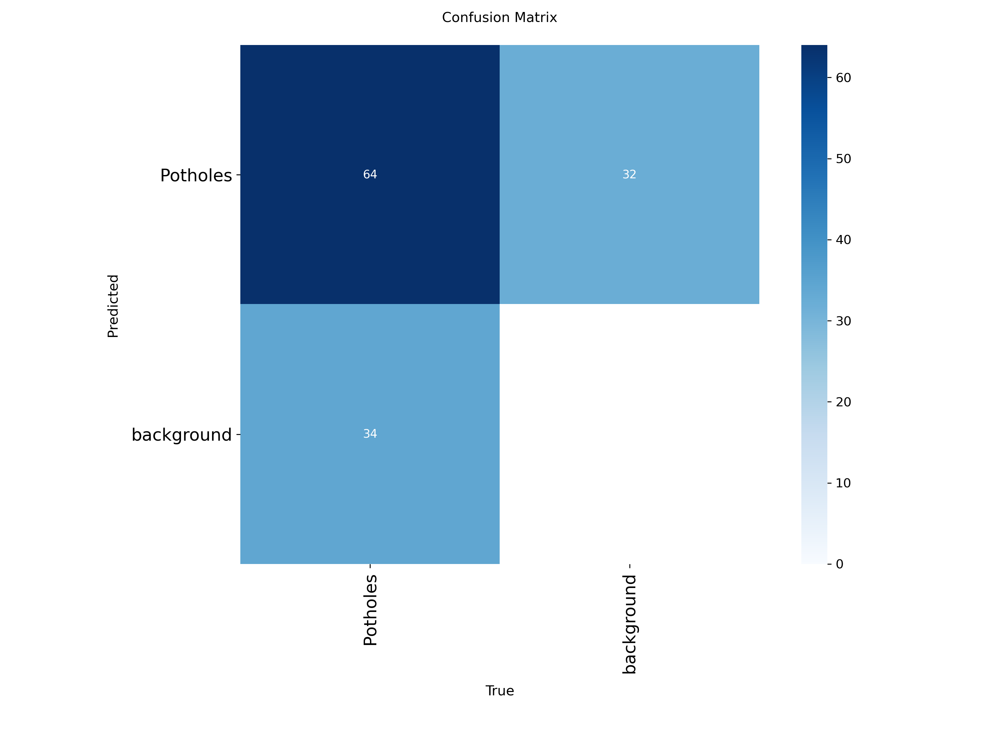

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/confusion_matrix.png', width = 900)

/content/datasets


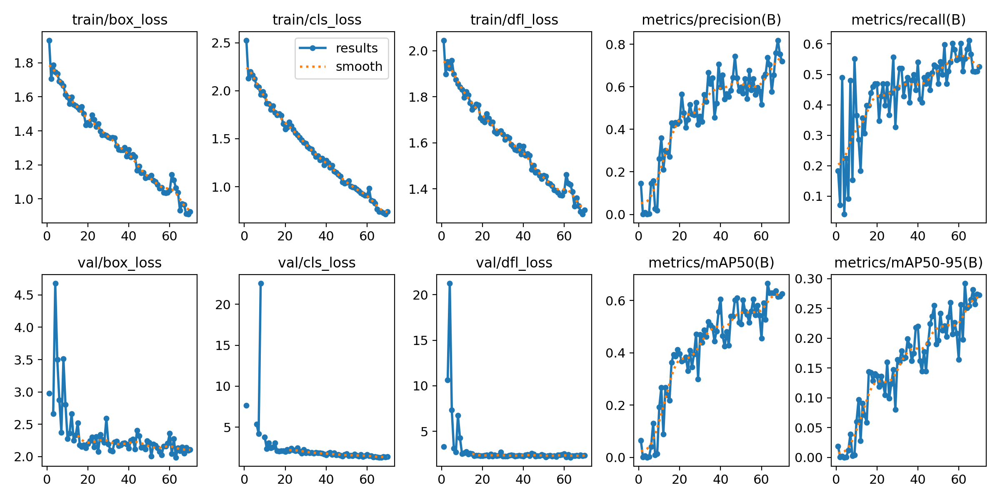

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/results.png', width = 600)

/content/datasets


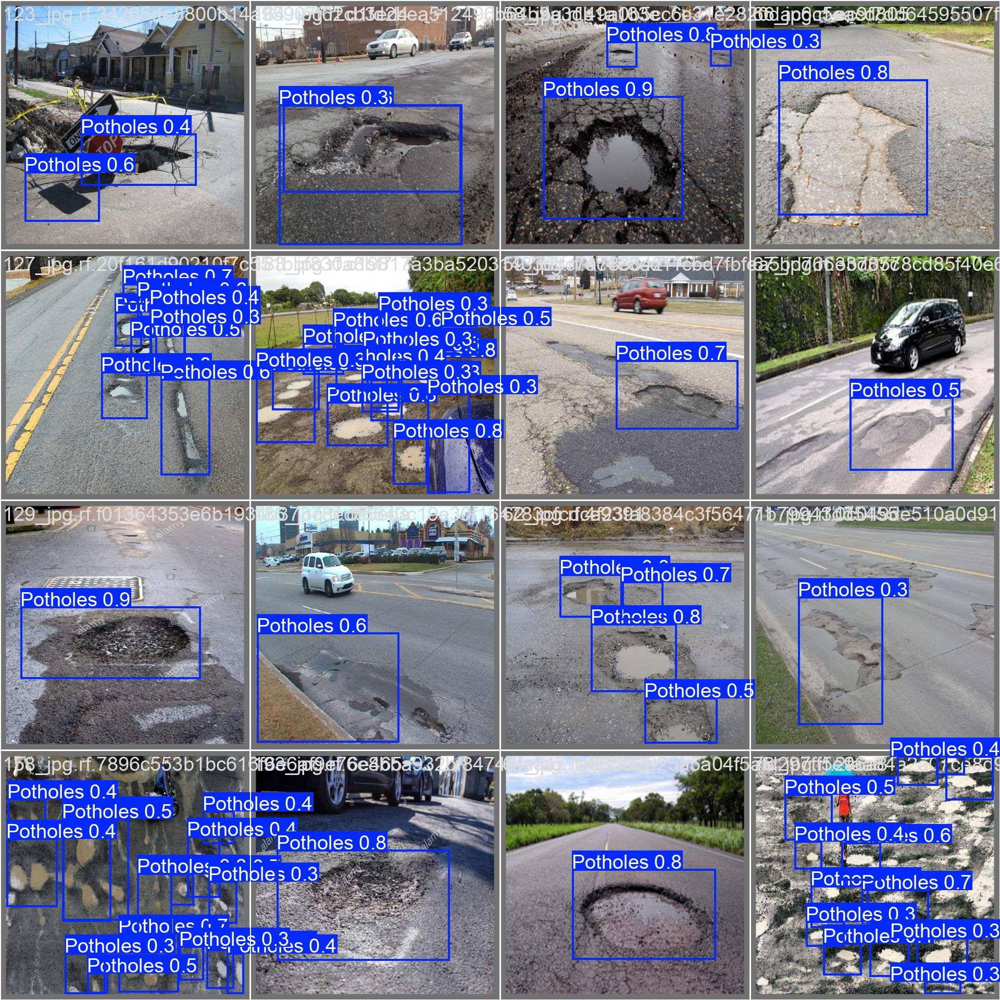

In [ ]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width = 600)

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model="{HOME}/runs/detect/train2/weights/best.pt" data="/content/datasets/Object-Detection-(Bounding-Box)-1/data.yaml"

/content/datasets
Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3169.2±819.9 MB/s, size: 88.5 KB)
val: Scanning /content/datasets/Object-Detection-(Bounding-Box)-1/valid/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 20/20 338.3Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6it/s 1.3s
                   all         20         98      0.725      0.551      0.663      0.292
Speed: 9.5ms preprocess, 37.1ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to /content/datasets/runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.25 source="/content/datasets/Object-Detection-(Bounding-Box)-1/test/images"

/content/datasets
Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs

image 1/20 /content/datasets/Object-Detection-(Bounding-Box)-1/test/images/106_jpg.rf.12693aed3783446751b93aeb94d8bafe.jpg: 640x640 5 Potholess, 37.0ms
image 2/20 /content/datasets/Object-Detection-(Bounding-Box)-1/test/images/111_jpg.rf.91472dc665da666b10d8fa58d88463aa.jpg: 640x640 1 Potholes, 36.9ms
image 3/20 /content/datasets/Object-Detection-(Bounding-Box)-1/test/images/131_jpg.rf.f49fe5d93fab29363b8b04f6b89d5330.jpg: 640x640 8 Potholess, 36.8ms
image 4/20 /content/datasets/Object-Detection-(Bounding-Box)-1/test/images/142_jpg.rf.ef9f025b2536187f2dbbbdb80bc8bfb1.jpg: 640x640 1 Potholes, 36.9ms
image 5/20 /content/datasets/Object-Detection-(Bounding-Box)-1/test/images/150_jpg.rf.7808eb72654e8521bb8b25743c94bbc4.jpg: 640x640 1 Potholes, 36.9ms
image 6/20 /content/datasets/Object-Detection-(Bounding-Box

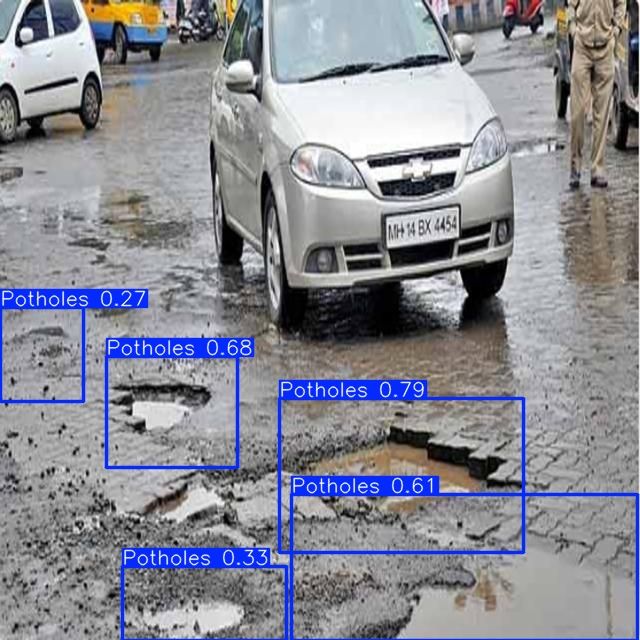

In [ ]:
Image('/content/datasets/runs/detect/predict/106_jpg.rf.12693aed3783446751b93aeb94d8bafe.jpg')


In [ ]:
%cd {HOME}

!yolo task=detect mode=predict model="{HOME}/runs/detect/train2/weights/best.pt" conf=0.25 source='/content/pothole_video.mp4'

/content/datasets
Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (frame 1/692) /content/pothole_video.mp4: 384x640 7 Potholess, 58.2ms
video 1/1 (frame 2/692) /content/pothole_video.mp4: 384x640 7 Potholess, 25.0ms
video 1/1 (frame 3/692) /content/pothole_video.mp4: 384x640 7 Potholess, 25.0ms
video 1/1 (frame 4/692) /content/pothole_video.mp4: 384x640 8 Potholess, 25.0ms
video 1/1 (frame 5/692) /content/pothole_video.mp4: 384x640 6 Potholess, 25.0ms
video 1/1 (frame 6/692) /content/pothole_video.mp4: 384x640 7 Potholess, 25.0ms
video 1/1 (frame 7/692) /content/pothole_video.mp4: 384x640 10 Potholess, 25.0ms
video 1/1 (frame 8/692) /content/pothole_video.mp4: 384x640 10 Potholess, 22.4ms
video 1/1 (frame 9/692) /content/pothole_video.mp4: 384x640 8 Potholess, 18.9ms
video 1/1 (frame 10/692) /content/pothole_video.mp4: 384x640 9 Potholess, 18.9ms
video 1/1 (fr

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/datasets/runs/detect/predict2/pothole_video.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""<video width="640" height="480" controls>
    <source src="{data_url}" type="video/mp4">
</video>""")


In [ ]:
from google.colab import drive
drive.mount('/content/drive')